# About the competitions

### Experiment with the largest-ever self-driving Prediction Dataset to build motion prediction model.

# Prediction Dataset sample

![](http://https://self-driving.lyft.com/wp-content/uploads/2020/06/motion_dataset_2-1.png)

![](https://self-driving.lyft.com/wp-content/uploads/2020/06/motion_dataset_2-1.png)

# What is autonomous vehicle ?
A self-driving car, also known as an autonomous vehicle (AV), connected and autonomous vehicle (CAV), driverless car, robo-car, or robotic car,(automated vehicles and fully automated vehicles in the European Union) is a vehicle that is capable of sensing its environment and moving safely with little or no human input.

Self-driving cars combine a variety of sensors to perceive their surroundings, such as radar, lidar, sonar, GPS, odometry and inertial measurement units. Advanced control systems interpret sensory information to identify appropriate navigation paths, as well as obstacles and relevant signage


# Example prediction solution

![](https://self-driving.lyft.com/wp-content/uploads/2020/06/diagram-prediction-1.jpg)

# Scene Visualisation

Code is taken from: 

https://github.com/lyft/l5kit

https://github.com/lyft/l5kit/blob/master/examples/visualisation/visualise_data.ipynb


In [1]:
!pip install --upgrade pip
!pip install pymap3d==2.1.0
!pip install -U l5kit

     |████████████████████████████████| 1.5 MB 2.8 MB/s 
  Attempting uninstall: pip
    Found existing installation: pip 20.2.1
    Uninstalling pip-20.2.1:
      Successfully uninstalled pip-20.2.1
  Created wheel for pymap3d: filename=pymap3d-2.1.0-py3-none-any.whl size=37449 sha256=af340405463196d00a5088b01ad9cdf05eb11e8de19449ef8f7c4674e5f028f3
  Stored in directory: /root/.cache/pip/wheels/07/c5/26/fea218a784fb6a7bdacdafd4a1019d8195f02f31a0ea4be35e
Successfully built pymap3d
     |████████████████████████████████| 81 kB 1.9 MB/s 
     |████████████████████████████████| 1.3 MB 7.9 MB/s 
     |████████████████████████████████| 3.3 MB 21.4 MB/s 
     |████████████████████████████████| 42.8 MB 71 kB/s 
     |████████████████████████████████| 6.6 MB 43.0 MB/s 
     |████████████████████████████████| 62 kB 1.2 MB/s 
     |████████████████████████████████| 3.8 MB 56.2 MB/s 
  Created wheel for zarr: filename=zarr-2.4.0-py3-none-any.whl size=127066 sha256=4019d8b542f0f29126c25ae1396afa4b

# Imports

In [2]:
import matplotlib.pyplot as plt

import numpy as np
import pandas as pd

from l5kit.data import ChunkedDataset, LocalDataManager
from l5kit.dataset import EgoDataset, AgentDataset

from l5kit.rasterization import build_rasterizer
from l5kit.configs import load_config_data
from l5kit.visualization import draw_trajectory, TARGET_POINTS_COLOR
from l5kit.geometry import transform_points
from tqdm import tqdm
from collections import Counter
from l5kit.data import PERCEPTION_LABELS
from prettytable import PrettyTable

import os

from matplotlib import animation, rc
from IPython.display import HTML

rc('animation', html='jshtml')

In [3]:
def animate_solution(images):

    def animate(i):
        im.set_data(images[i])
 
    fig, ax = plt.subplots()
    im = ax.imshow(images[0])
    
    return animation.FuncAnimation(fig, animate, frames=len(images), interval=60)

In [4]:
# set env variable for data
os.environ["L5KIT_DATA_FOLDER"] = "../input/lyft-motion-prediction-autonomous-vehicles"
# get config
cfg = load_config_data("../input/lyft-config-files/visualisation_config.yaml")
print(cfg)

{'format_version': 4, 'model_params': {'model_architecture': 'resnet50', 'history_num_frames': 0, 'history_step_size': 1, 'history_delta_time': 0.1, 'future_num_frames': 50, 'future_step_size': 1, 'future_delta_time': 0.1}, 'raster_params': {'raster_size': [224, 224], 'pixel_size': [0.5, 0.5], 'ego_center': [0.25, 0.5], 'map_type': 'py_semantic', 'satellite_map_key': 'aerial_map/aerial_map.png', 'semantic_map_key': 'semantic_map/semantic_map.pb', 'dataset_meta_key': 'meta.json', 'filter_agents_threshold': 0.5}, 'val_data_loader': {'key': 'scenes/sample.zarr', 'batch_size': 12, 'shuffle': False, 'num_workers': 16}}


# Load the data

In [5]:
dm = LocalDataManager()
dataset_path = dm.require(cfg["val_data_loader"]["key"])
zarr_dataset = ChunkedDataset(dataset_path)
zarr_dataset.open()
print(zarr_dataset)

+------------+------------+------------+-----------------+----------------------+----------------------+----------------------+---------------------+
| Num Scenes | Num Frames | Num Agents | Total Time (hr) | Avg Frames per Scene | Avg Agents per Frame | Avg Scene Time (sec) | Avg Frame frequency |
+------------+------------+------------+-----------------+----------------------+----------------------+----------------------+---------------------+
|    100     |   24838    |  1893736   |       0.69      |        248.38        |        76.24         |        24.83         |        10.00        |
+------------+------------+------------+-----------------+----------------------+----------------------+----------------------+---------------------+


# DATA FORMAT


 The dataset is provided in zarr format. The zarr files are flat, compact, and highly performant for loading. To read the dataset please use our new Python software kit.
 The dataset consists of frames and agent states. A frame is a snapshot in time which consists of ego pose, time, and multiple agent states. Each agent state describes the position, orientation, bounds, and type.

# EXAMPLE

In [6]:
import zarr

In [7]:
train_zarr = zarr.open("../input/lyft-motion-prediction-autonomous-vehicles/scenes/train.zarr")

print(type(train_zarr))


<class 'zarr.hierarchy.Group'>


In [8]:
train_zarr.info

Name,/
Type,zarr.hierarchy.Group
Read-only,False
Store type,zarr.storage.DirectoryStore
No. members,5
No. arrays,4
No. groups,1
Arrays,"agents, frames, scenes, traffic_light_faces"
Groups,agents_mask


### The 2020 Lyft competition dataset is stored in four structured arrays: scenes, frames, agents and tl_faces.
 *Note: in the following all _interval fields assume that information is stored consecutively in the arrays. This means that if frame_index_interval for scene_0 is (0, 100), frames from scene_1 will start from index 100 in the frames array.*

 Reading from a zarr array is as easy as slicing from it like you would any numpy array. The return value is an ordinary numpy array. Zarr takes care of determining which chunks to read from.

In [9]:
train_zarr.agents[:5]

array([([  665.03424072, -2207.51220703], [4.3913283 , 1.8138304 , 1.5909758 ],  1.0166751 , [0., 0.], 1, [0., 0., 0., 1., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.]),
       ([  717.66125488, -2173.76000977], [5.150925  , 1.9530917 , 2.04021   ], -0.783224  , [0., 0.], 2, [0., 0., 0., 1., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.]),
       ([  730.68139648, -2180.67895508], [2.9482825 , 1.4842174 , 1.1125067 ], -0.321747  , [0., 0.], 3, [0., 0., 0., 1., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.]),
       ([  671.25360107, -2204.74536133], [1.7067024 , 0.9287868 , 0.6282158 ],  0.78550094, [0., 0.], 4, [0., 1., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.]),
       ([  669.77630615, -2213.00463867], [0.25109944, 0.6343781 , 1.654377  ],  1.4923593 , [0., 0.], 5, [0., 1., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.])],
      dtype=[('centroid', '<f8', (2,)), ('extent', '<f4', (3,)), ('yaw', '<f4'), ('velocity', '<f4', (2,)), ('trac

# Data Overview

In [10]:
agents = zarr_dataset.agents
probabilities = agents["label_probabilities"]
labels_indexes = np.argmax(probabilities, axis=1)
counts = []
for idx_label, label in enumerate(PERCEPTION_LABELS):
    counts.append(np.sum(labels_indexes == idx_label))
    
table = PrettyTable(field_names=["label", "counts"])
for count, label in zip(counts, PERCEPTION_LABELS):
    table.add_row([label, count])
print(table)

+------------------------------------+---------+
|               label                |  counts |
+------------------------------------+---------+
|      PERCEPTION_LABEL_NOT_SET      |    0    |
|      PERCEPTION_LABEL_UNKNOWN      | 1324481 |
|     PERCEPTION_LABEL_DONTCARE      |    0    |
|        PERCEPTION_LABEL_CAR        |  519385 |
|        PERCEPTION_LABEL_VAN        |    0    |
|       PERCEPTION_LABEL_TRAM        |    0    |
|        PERCEPTION_LABEL_BUS        |    0    |
|       PERCEPTION_LABEL_TRUCK       |    0    |
| PERCEPTION_LABEL_EMERGENCY_VEHICLE |    0    |
|   PERCEPTION_LABEL_OTHER_VEHICLE   |    0    |
|      PERCEPTION_LABEL_BICYCLE      |    0    |
|    PERCEPTION_LABEL_MOTORCYCLE     |    0    |
|      PERCEPTION_LABEL_CYCLIST      |   6688  |
|   PERCEPTION_LABEL_MOTORCYCLIST    |    0    |
|    PERCEPTION_LABEL_PEDESTRIAN     |  43182  |
|      PERCEPTION_LABEL_ANIMAL       |    0    |
|     AVRESEARCH_LABEL_DONTCARE      |    0    |
+-------------------

In [11]:
rast = build_rasterizer(cfg, dm)
dataset = EgoDataset(cfg, zarr_dataset, rast)

# Autonomous Vehicle with Trajectory

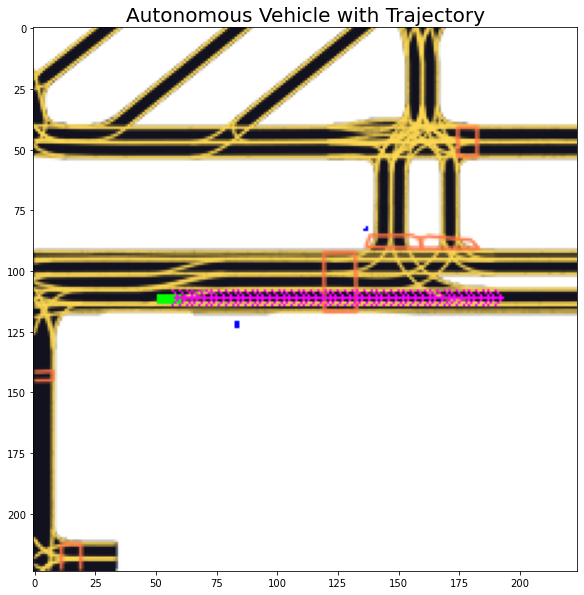

In [12]:
data = dataset[80]

im = data["image"].transpose(1, 2, 0)
im = dataset.rasterizer.to_rgb(im)
target_positions_pixels = transform_points(data["target_positions"] + data["centroid"][:2], data["world_to_image"])
draw_trajectory(im, target_positions_pixels, data["target_yaws"], TARGET_POINTS_COLOR)
figsize = plt.subplots(figsize = (10,10))
plt.title('Autonomous Vehicle with Trajectory',fontsize=20)

plt.imshow(im[::-1])
plt.show()

# Satellite View

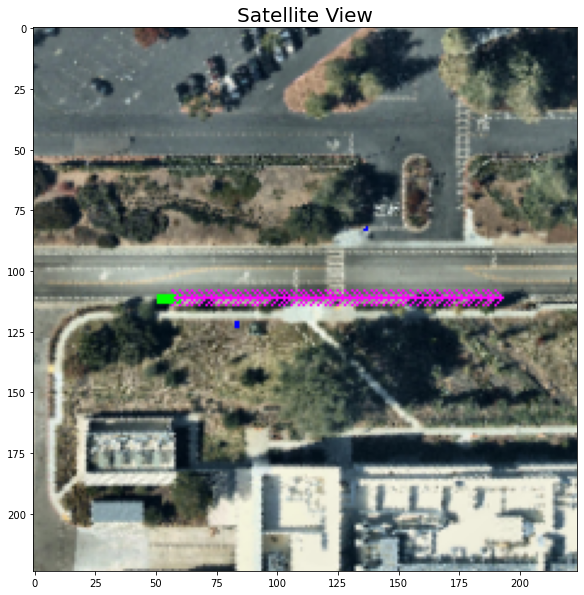

In [13]:
cfg["raster_params"]["map_type"] = "py_satellite"
rast = build_rasterizer(cfg, dm)
dataset = EgoDataset(cfg, zarr_dataset, rast)
data = dataset[80]

im = data["image"].transpose(1, 2, 0)
im = dataset.rasterizer.to_rgb(im)
target_positions_pixels = transform_points(data["target_positions"] + data["centroid"][:2], data["world_to_image"])
draw_trajectory(im, target_positions_pixels, data["target_yaws"], TARGET_POINTS_COLOR)
figsize = plt.subplots(figsize = (10,10))
plt.title('Satellite View',fontsize=20)
plt.imshow(im[::-1])
plt.show()

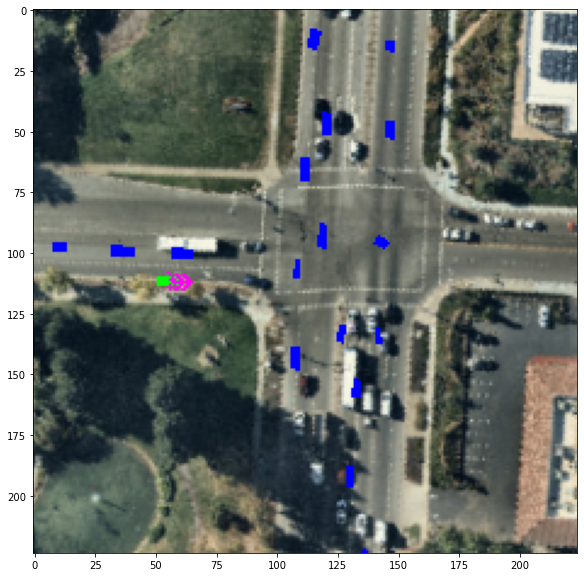

In [14]:
dataset = AgentDataset(cfg, zarr_dataset, rast)
data = dataset[80]

im = data["image"].transpose(1, 2, 0)
im = dataset.rasterizer.to_rgb(im)
target_positions_pixels = transform_points(data["target_positions"] + data["centroid"][:2], data["world_to_image"])
draw_trajectory(im, target_positions_pixels, data["target_yaws"], TARGET_POINTS_COLOR)

fig = plt.subplots(figsize=(10,10))
plt.imshow(im[::-1])
plt.show()

 Green represents the autonomous vehicle (AV), and blue is primarily all the other cars/vehicles/exogenous factors we need to predict for.
 If we are able to accurately predict the path the vehicles go through, it will make it easier for an AV to compute its trajectory on the fly.

#  Entire Scene

## Semantic

What is semantic map?



In [15]:
from IPython.display import display, clear_output
import PIL
 
cfg["raster_params"]["map_type"] = "py_semantic"
rast = build_rasterizer(cfg, dm)
dataset = EgoDataset(cfg, zarr_dataset, rast)
scene_idx = 34
indexes = dataset.get_scene_indices(scene_idx)
images = []

for idx in indexes:
    
    data = dataset[idx]
    im = data["image"].transpose(1, 2, 0)
    im = dataset.rasterizer.to_rgb(im)
    target_positions_pixels = transform_points(data["target_positions"] + data["centroid"][:2], data["world_to_image"])
    center_in_pixels = np.asarray(cfg["raster_params"]["ego_center"]) * cfg["raster_params"]["raster_size"]
    draw_trajectory(im, target_positions_pixels, data["target_yaws"], TARGET_POINTS_COLOR)
    clear_output(wait=True)
    images.append(PIL.Image.fromarray(im[::-1]))

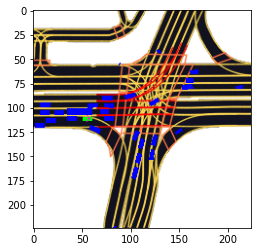

In [16]:
anim = animate_solution(images)
HTML(anim.to_jshtml())

## Satellite

In [17]:
from IPython.display import display, clear_output
import PIL
 
cfg["raster_params"]["map_type"] = "py_satellite"
rast = build_rasterizer(cfg, dm)
dataset = EgoDataset(cfg, zarr_dataset, rast)
scene_idx = 34
indexes = dataset.get_scene_indices(scene_idx)
images = []


for i, idx in enumerate(indexes):
    data = dataset[idx]
    im = data["image"].transpose(1, 2, 0)
    im = dataset.rasterizer.to_rgb(im)
    target_positions_pixels = transform_points(data["target_positions"] + data["centroid"][:2], data["world_to_image"])
    center_in_pixels = np.asarray(cfg["raster_params"]["ego_center"]) * cfg["raster_params"]["raster_size"]
    draw_trajectory(im, target_positions_pixels, data["target_yaws"], TARGET_POINTS_COLOR)
    clear_output(wait=True)
    images.append(PIL.Image.fromarray(im[::-1]))

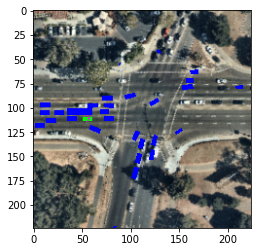

In [18]:
anim = animate_solution(images)
HTML(anim.to_jshtml())

# Sample Submission

In [19]:
DIR_INPUT = "/kaggle/input/lyft-motion-prediction-autonomous-vehicles"

SINGLE_MODE_SUBMISSION = f"{DIR_INPUT}/single_mode_sample_submission.csv"
MULTI_MODE_SUBMISSION = f"{DIR_INPUT}/multi_mode_sample_submission.csv"

In [20]:
# Single mode
sample_submission = pd.read_csv(SINGLE_MODE_SUBMISSION)

# Multi mode
# sample_submission = pd.read_csv(MULTI_MODE_SUBMISSION)

In [21]:
sample_submission.head()


,timestamp,track_id,conf_0,conf_1,conf_2,coord_x00,coord_y00,coord_x01,coord_y01,coord_x02,...,coord_x245,coord_y245,coord_x246,coord_y246,coord_x247,coord_y247,coord_x248,coord_y248,coord_x249,coord_y249
0,1578606007801600134,2,1.0,0.0,0.0,-1.56912,-0.59477,-0.86741,-0.24735,-0.31516,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,1578606032802467516,4,1.0,0.0,0.0,-0.92120,1.39096,-0.35505,1.58513,1.11564,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,1578606032802467516,5,1.0,0.0,0.0,0.43730,0.47827,-0.21025,-0.66553,-0.11192,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,1578606032802467516,81,1.0,0.0,0.0,-1.59000,1.60620,-0.77065,-0.31258,0.23285,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,1578606032802467516,130,1.0,0.0,0.0,1.42988,-1.44712,0.11758,-0.38717,1.41222,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [22]:
sample_submission.to_csv("submission.csv", index=False)